In [1]:
!uv pip install opencv-python-headless matplotlib

Using Python 3.13.2 environment at: /Users/morizin/Documents/Code/crash-detection-project/.venv
Resolved 12 packages in 530ms                                        
⠙ Preparing packages... (0/9)                                                   
⠙ Preparing packages... (0/9)--------------     0 B/8.13 KiB            
⠙ Preparing packages... (0/9)---------- 8.13 KiB/8.13 KiB           
⠙ Preparing packages... (0/9)---------- 8.13 KiB/8.13 KiB           
cycler               ------------------------------ 8.13 KiB/8.13 KiB
⠙ Preparing packages... (0/9)--------------     0 B/118.94 KiB          
cycler               ------------------------------ 8.13 KiB/8.13 KiB
⠙ Preparing packages... (0/9)-------------- 14.85 KiB/118.94 KiB        
cycler               ------------------------------ 8.13 KiB/8.13 KiB
⠙ Preparing packages... (0/9)-------------- 14.85 KiB/118.94 KiB        
⠙ Preparing packages... (0/9)-------------- 14.85 KiB/118.94 KiB        
⠙ Preparing packages... (0/9)-----------

In [2]:
import matplotlib.pyplot as plt
import cv2
import os

os.chdir("/Users/morizin/Documents/Code/crash-detection-project")

In [3]:
from PIL import Image
import numpy as np

image = Image.open("artifacts/data/gta-crash/train_images/00000_01.jpg")
np.array( image.getdata())

/var/folders/_5/7wj37gsd289bc_q9b4lsrfk80000gn/T/ipykernel_86170/1479055860.py:5: DeprecationWarning: Image.Image.getdata is deprecated and will be removed in Pillow 14 (2027-10-15). Use get_flattened_data instead.
  np.array( image.getdata())


array([[21, 20, 26],
       [21, 20, 26],
       [21, 20, 26],
       ...,
       [16, 22, 36],
       [15, 21, 35],
       [15, 21, 35]], shape=(284000, 3))

In [4]:
import cv2
image = cv2.imread("artifacts/data/gta-crash/train_images/00000_01.jpg")
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

In [5]:
image

array([[[21, 20, 26],
        [21, 20, 26],
        [21, 20, 26],
        ...,
        [18, 18, 26],
        [18, 18, 26],
        [18, 18, 26]],

       [[21, 20, 26],
        [21, 20, 26],
        [21, 20, 26],
        ...,
        [18, 18, 26],
        [18, 18, 26],
        [18, 18, 26]],

       [[21, 20, 26],
        [21, 20, 26],
        [21, 20, 26],
        ...,
        [18, 18, 26],
        [18, 18, 26],
        [18, 18, 26]],

       ...,

       [[31, 32, 37],
        [31, 32, 37],
        [30, 31, 36],
        ...,
        [16, 22, 36],
        [16, 22, 36],
        [15, 21, 35]],

       [[30, 31, 36],
        [30, 31, 36],
        [31, 32, 37],
        ...,
        [16, 22, 36],
        [15, 21, 35],
        [15, 21, 35]],

       [[30, 31, 36],
        [30, 31, 36],
        [31, 32, 37],
        ...,
        [16, 22, 36],
        [15, 21, 35],
        [15, 21, 35]]], shape=(400, 710, 3), dtype=uint8)

In [5]:
import pandas as pd
import os

DATA_DIR = "artifacts/data/gta-crash"
data = pd.read_csv(os.path.join(DATA_DIR, "train.csv"))

In [6]:
data.tail()

,id,vid,fid,filename,acceleration,speed,angularVelocity_x,angularVelocity_y,angularVelocity_z,forwardV_x,...,forwardV_z,objectSize_x,objectSize_y,objectSize_z,position_x,position_y,position_z,vehicleCount,vehicleInfo,target
227615,073215.json,11380,15,11380_15.jpg,0.248977,5.979051,-0.246291,-0.010319,-0.328928,-0.503003,...,0.215861,1.830663,4.458614,1.562617,253.1992,418.0431,117.6697,2,"[{'acceleration': 0.0358205624, 'adaptedLabel'...",0
227616,073216.json,11380,16,11380_16.jpg,0.359966,5.835709,-0.192600,0.008540,-0.283081,-0.471276,...,0.201625,1.830663,4.458614,1.562617,252.9135,418.6130,117.8059,2,"[{'acceleration': 0.0123207942, 'adaptedLabel'...",0
227617,073217.json,11380,17,11380_17.jpg,0.460306,5.918653,-0.160488,0.006207,-0.216547,-0.447540,...,0.191559,1.830663,4.458614,1.562617,252.6687,419.1363,117.9259,1,"[{'acceleration': 0.0141938664, 'adaptedLabel'...",0
227618,073218.json,11380,18,11380_18.jpg,0.559434,6.072042,-0.098109,0.027629,-0.152298,-0.430272,...,0.183543,1.830663,4.458614,1.562617,252.4281,419.6678,118.0454,1,"[{'acceleration': 0.04257456, 'adaptedLabel': ...",0
227619,073219.json,11380,19,11380_19.jpg,0.659831,6.291671,-0.014733,0.057569,-0.101652,-0.417693,...,0.184785,1.830663,4.458614,1.562617,252.1779,420.2263,118.1608,1,"[{'acceleration': 0.07440346, 'adaptedLabel': ...",0


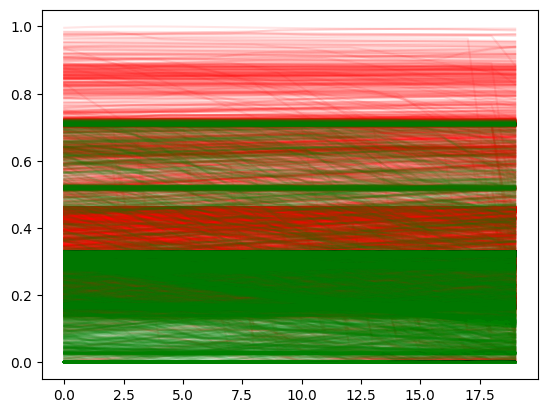

In [14]:
import random

# samples = data[data['vid'].isin(random.choices(data.vid.unique(), k = 10))]
samples = data.copy()
feature = "speed"
# Normalize video-by-video
# samples[f'{feature}_min'] = samples.groupby('vid')[feature].transform('min')
# samples[f'{feature}_max'] = samples.groupby('vid')[feature].transform('max')
# samples[feature] = (samples[feature] - samples[f'{feature}_min']) / (samples[f'{feature}_max'] - samples[f'{feature}_min'] + 1e-8)
samples[feature] = (samples[feature]) / (samples[feature].max() - samples[feature].min())
target = samples.target[::20].values
acc = samples[feature].values.reshape(-1, 20)

for i in range(len(target)):
    # if target[i] == 0:
    plt.plot(list(range(20)), acc[i], "r" if target[i] else "g", alpha=0.1)
plt.show()

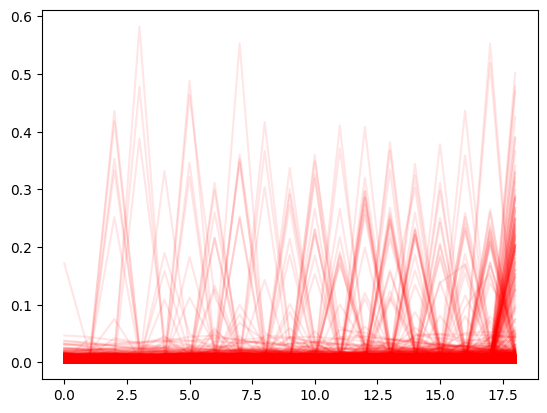

In [19]:
# But all o this feature values are plotted. Let me try to plot there delta values.
import numpy as np  
delta_acc = np.abs(np.diff(acc, axis=1))
for i in range(len(target)):
    if target[i] == 1:
        plt.plot(list(range(19)), delta_acc[i], "r" if target[i] else "g", alpha=0.1)
    # plt.plot(list(range(19)), delta_acc[i], "r" if target[i] else "g", alpha=0.1)
plt.show()

In [21]:
delta_acc.shape

(11381, 19)

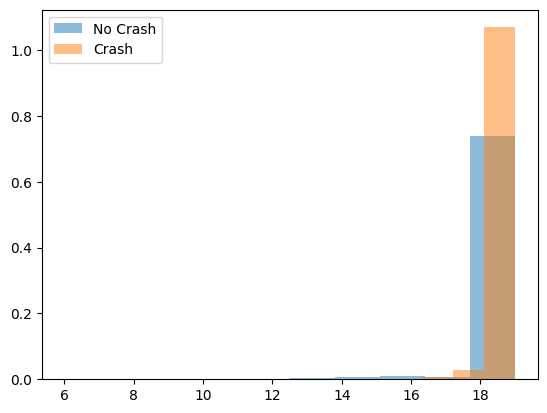

In [23]:
# Let me check the acceleration distribution at 19th frame, kde plot
acc_19 = (delta_acc < 0.03).astype(int).sum(axis = 1)
# acc_19 = acc[:, 14]
plt.hist(acc_19[target == 0].flatten(), bins=10, alpha=0.5, label="No Crash", density=True)
plt.hist(acc_19[target == 1].flatten(), bins=10, alpha=0.5, label="Crash", density=True)

plt.legend()
plt.show()

From this plot we can understand if the speed is below 0.18 then its non crash and if speed is 0.76 then crash will happen. the middle values will have random probability of 0.7 and 0.3 for crash non crash  randomly

In [26]:
from sklearn.metrics import accuracy_score, classification_report
for thr in np.linspace(0, 1, 100):
    acc_19 = (delta_acc < thr).sum(axis=1) 
    predictions = (acc_19 >= 2).astype(int)
    print(f"Threshold: {thr:.3f}, Accuracy: {accuracy_score(target, predictions):.4f}")

target = samples.target[::20].values
acc_19 = (delta_acc > 0.131).sum(axis=1)

predictions = (acc_19 >= 2).astype(int)
# predictions = np.ones_like(acc_19)
print(classification_report(target, predictions))

Threshold: 0.000, Accuracy: 0.3217
Threshold: 0.010, Accuracy: 0.6781
Threshold: 0.020, Accuracy: 0.6783
Threshold: 0.030, Accuracy: 0.6783
Threshold: 0.040, Accuracy: 0.6783
Threshold: 0.051, Accuracy: 0.6783
Threshold: 0.061, Accuracy: 0.6783
Threshold: 0.071, Accuracy: 0.6783
Threshold: 0.081, Accuracy: 0.6783
Threshold: 0.091, Accuracy: 0.6783
Threshold: 0.101, Accuracy: 0.6783
Threshold: 0.111, Accuracy: 0.6783
Threshold: 0.121, Accuracy: 0.6783
Threshold: 0.131, Accuracy: 0.6783
Threshold: 0.141, Accuracy: 0.6783
Threshold: 0.152, Accuracy: 0.6783
Threshold: 0.162, Accuracy: 0.6783
Threshold: 0.172, Accuracy: 0.6783
Threshold: 0.182, Accuracy: 0.6783
Threshold: 0.192, Accuracy: 0.6783
Threshold: 0.202, Accuracy: 0.6783
Threshold: 0.212, Accuracy: 0.6783
Threshold: 0.222, Accuracy: 0.6783
Threshold: 0.232, Accuracy: 0.6783
Threshold: 0.242, Accuracy: 0.6783
Threshold: 0.253, Accuracy: 0.6783
Threshold: 0.263, Accuracy: 0.6783
Threshold: 0.273, Accuracy: 0.6783
Threshold: 0.283, Ac

In [69]:
f18_speed = acc[:, 18]
# f18_speed = a
target = samples.target[::20].values

predictions = f18_speed
predictions[predictions < 0.16] = 0
predictions[(predictions >= 0.16) & (predictions <= 0.33)] = random.choices([0, 1], k=len(predictions[(predictions >= 0.16) & (predictions <= 0.33)]), weights=[0.5, 0.5])

predictions[(predictions > 0.33) & (predictions <= 0.48)] = random.choices([0, 1], k=len(predictions[(predictions > 0.33) & (predictions <= 0.48)]), weights=[0.2, 0.8])
predictions[(predictions > 0.48) & (predictions <= 0.72)] = random.choices([0, 1], k=len(predictions[(predictions > 0.48) & (predictions <= 0.72)]), weights=[0.5, 0.5])

predictions[predictions > 0.72] = 1
# predictions[predictions < -0.09] = random.choices([0, 1], k=len(predictions[predictions < -0.09]), weights=[0.5, 0.5])
# predictions[(predictions >= -0.09) & (predictions <= 0)] = 0
# predictions[(predictions > 0) & (predictions <= 0.32)] = 1
# predictions[(predictions > 0.32) & (predictions <= 0.46)] = random.choices([0, 1], k=len(predictions[(predictions > 0.32) & (predictions <= 0.46)]), weights=[0.5, 0.5])
# predictions[predictions > 0.46] = 0

predictions = predictions.astype(int)

from sklearn.metrics import classification_report

print(classification_report(target, predictions))

              precision    recall  f1-score   support

           0       0.41      0.64      0.50      3661
           1       0.77      0.56      0.65      7720

    accuracy                           0.59     11381
   macro avg       0.59      0.60      0.57     11381
weighted avg       0.65      0.59      0.60     11381



Animation size has reached 21199663 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


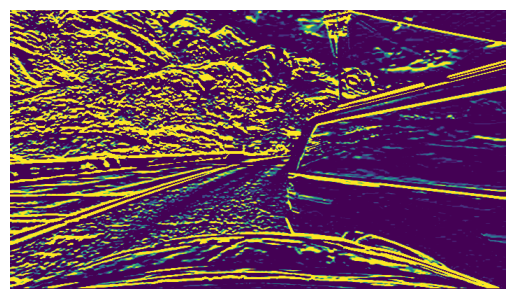

In [13]:
from matplotlib.animation import FuncAnimation
from IPython.display import HTML
import random
from matplotlib import rc
rc('animation', html='jshtml')

samples = data[data['vid'].isin(random.choices(data.vid.unique(), k = 10))]

id = 1
fig, ax = plt.subplots()
image = ax.imshow(cv2.cvtColor(cv2.imread(os.path.join(DATA_DIR, "train_images", samples.iloc[id].filename)), cv2.COLOR_BGR2RGB))
ax.axis('off')

def update(frame):
    img = cv2.cvtColor(cv2.imread(os.path.join(DATA_DIR, "train_images", samples.iloc[id*20 + frame].filename)), cv2.COLOR_BGR2GRAY)
    # img[200:,:] = cv2.Canny(img[200:,:], 200, 210)
    img = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=5)
    image.set_array(img)
    return [image]

ani = FuncAnimation(fig, update, frames=range(100), blit=True, repeat=False, interval=100)

HTML(ani.to_jshtml())

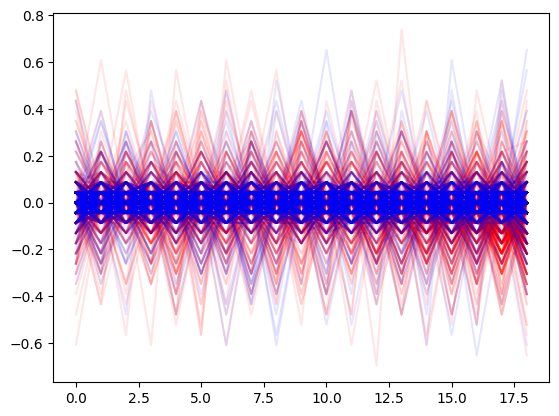